# Clustering Crypto

In [1]:
# Initial imports
import requests
import pandas as pd
import matplotlib.pyplot as plt
import hvplot.pandas
import plotly.express as px
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import pprint
from pandas.io.json import json_normalize


Bad key "text.kerning_factor" on line 4 in
C:\Users\amuni\anaconda3\envs\pyvizenv\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
http://github.com/matplotlib/matplotlib/blob/master/matplotlibrc.template
or from the matplotlib source distribution


### Fetching Cryptocurrency Data

In [2]:
# Use the following endpoint to fetch json data
url = "https://min-api.cryptocompare.com/data/all/coinlist"
r=requests.get(url)
pprint.pprint(r.json())
crypto_json=r.json()

{'BaseImageUrl': 'https://www.cryptocompare.com',
 'BaseLinkUrl': 'https://www.cryptocompare.com',
 'Data': {'$BASED': {'Algorithm': 'N/A',
                     'BuiltOn': '7605',
                     'CoinName': 'Based Money',
                     'ContentCreatedOn': 1599121169,
                     'DecimalPlaces': 18,
                     'FullName': 'Based Money ($BASED)',
                     'FullyPremined': '0',
                     'Id': '936356',
                     'ImageUrl': '/media/37305412/based.png',
                     'IsTrading': True,
                     'Name': '$BASED',
                     'PreMinedValue': 'N/A',
                     'ProofType': 'N/A',
                     'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                          'Rating': '',
                                          'TechnologyAdoptionRating': ''}},
                     'SmartContractAddress': '0x68A118Ef45063051Eac49c7e647CE5Ace48a68a5',
                 

                               'FCA': 'Exchange,Utility',
                               'FINMA': 'Payment,Utility',
                               'Industry': 'Information and Communication'},
                  'TotalCoinSupply': '1000000000',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 1000000000,
                  'Url': '/coins/aac/overview'},
          'AAP.CUR': {'Algorithm': 'N/A',
                      'BlockNumber': 0,
                      'BlockReward': 0,
                      'BlockTime': 0,
                      'BuiltOn': '7605',
                      'CoinName': 'Advance Auto Parts',
                      'ContentCreatedOn': 1590746664,
                      'DecimalPlaces': 8,
                      'FullName': 'Advance Auto Parts (AAP.CUR)',
                      'FullyPremined': '0',
                      'Id': '935085',
                      'ImageUrl': '/media/36935219/currencycom.png',
                      'IsTrading': True

                   'TotalCoinsFreeFloat': 'N/A',
                   'TotalCoinsMined': 24788538.1468513,
                   'Url': '/coins/adai/overview'},
          'ADAUP': {'Algorithm': 'N/A',
                    'BuiltOn': 'N/A',
                    'CoinName': 'ADAUP',
                    'ContentCreatedOn': 1594901358,
                    'DecimalPlaces': 0,
                    'FullName': 'ADAUP (ADAUP)',
                    'FullyPremined': '0',
                    'Id': '935877',
                    'ImageUrl': '/media/9350818/binance.png',
                    'IsTrading': True,
                    'Name': 'ADAUP',
                    'PreMinedValue': 'N/A',
                    'ProofType': 'N/A',
                    'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                         'Rating': '',
                                         'TechnologyAdoptionRating': ''}},
                    'SmartContractAddress': 'N/A',
                    'SortOrder'

                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 7896754783.81,
                  'Url': '/coins/aic/overview'},
          'AICO': {'Algorithm': 'N/A',
                   'BlockNumber': 0,
                   'BlockReward': 0,
                   'BlockTime': 0,
                   'BuiltOn': '7605',
                   'CoinName': 'AICON',
                   'ContentCreatedOn': 1596542768,
                   'DecimalPlaces': 8,
                   'FullName': 'AICON (AICO)',
                   'FullyPremined': '0',
                   'Id': '936055',
                   'ImageUrl': '/media/37072297/aico.png',
                   'IsTrading': True,
                   'Name': 'AICO',
                   'NetHashesPerSecond': 0,
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                             

                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': '0xf2cdf38e24738ba379ffa38d47bc88a941df5627',
                  'SortOrder': '4847',
                  'Sponsored': False,
                  'Symbol': 'ALY',
                  'Taxonomy': {'Access': 'Permissionless',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': 'No',
                               'CollateralizedAssetType': '',
                               'FCA': 'Utility',
                               'FINMA': 'Utility',
                               'Industry': 'Information and Communication'},
                 

                  'FullName': 'AlpaCoin (APC)',
                  'FullyPremined': '0',
                  'Id': '20722',
                  'ImageUrl': '/media/350956/apc.png',
                  'IsTrading': True,
                  'Name': 'APC',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'PoW',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': 'N/A',
                  'SortOrder': '563',
                  'Sponsored': False,
                  'Symbol': 'APC',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
    

                   'BuiltOn': '7605',
                   'CoinName': 'Artfinity Token',
                   'ContentCreatedOn': 1560432540,
                   'DecimalPlaces': 5,
                   'FullName': 'Artfinity Token (ARTF)',
                   'FullyPremined': '0',
                   'Id': '930853',
                   'ImageUrl': '/media/35650826/at.png',
                   'IsTrading': True,
                   'Name': 'ARTF',
                   'NetHashesPerSecond': 0,
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': '0xe54b3458c47e44c37a267e7c633afef88287c294',
                   'SortOrder': '4350',
                   'Sponsored': False,
                   'Symbol': 'ARTF',
                   'Taxonomy'

                   'BuiltOn': '7605',
                   'CoinName': 'Cube',
                   'ContentCreatedOn': 1521121521,
                   'DecimalPlaces': 18,
                   'FullName': 'Cube (AUTO)',
                   'FullyPremined': '0',
                   'Id': '815399',
                   'ImageUrl': '/media/30001729/untitled-1.png',
                   'IsTrading': True,
                   'Name': 'AUTO',
                   'NetHashesPerSecond': 0,
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': '0x622dFfCc4e83C64ba959530A5a5580687a57581b',
                   'SortOrder': '2472',
                   'Sponsored': False,
                   'Symbol': 'AUTO',
                   'Taxonomy': {'Access': 

                  'Taxonomy': {'Access': 'Permissionless',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': 'No',
                               'CollateralizedAssetType': '',
                               'FCA': 'Utility',
                               'FINMA': 'Utility',
                               'Industry': 'Wholesale and Retail Trade'},
                  'TotalCoinSupply': 'N/A',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 1034078486.09159,
                  'Url': '/coins/bay/overview'},
          'BB1': {'Algorithm': 'N/A',
                  'BuiltOn': '4614',
                  'CoinName': 'Bitbond',
                  'ContentCreatedOn': 1551184694,
                  'DecimalPlaces': 0,
                  'FullName': 'Bitbond (BB1)',
                  'FullyPremined': '0',
                  'Id': '929173',
                  

                  'Url': '/coins/bcx/overview'},
          'BCY': {'Algorithm': 'Counterparty',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '5292',
                  'CoinName': 'BitCrystals',
                  'ContentCreatedOn': 1465057801,
                  'DecimalPlaces': 0,
                  'FullName': 'BitCrystals (BCY)',
                  'FullyPremined': '1',
                  'Id': '20315',
                  'ImageUrl': '/media/350903/bcy.png',
                  'IsTrading': True,
                  'Name': 'BCY',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': 'N/A',
           

                    'Url': '/coins/bhive/overview'},
          'BHP': {'Algorithm': 'N/A',
                  'BuiltOn': 'N/A',
                  'CoinName': 'Blockchain of Hash Power',
                  'ContentCreatedOn': 1567692441,
                  'DecimalPlaces': 0,
                  'FullName': 'Blockchain of Hash Power (BHP)',
                  'FullyPremined': '0',
                  'Id': '931857',
                  'ImageUrl': '/media/35651414/bhp.png',
                  'IsTrading': True,
                  'Name': 'BHP',
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': 'N/A',
                  'SortOrder': '4541',
                  'Sponsored': False,
                  'Symbol': 'BHP',
                  'Taxono

                  'FullyPremined': '0',
                  'Id': '757969',
                  'ImageUrl': '/media/27010664/bix.png',
                  'IsTrading': True,
                  'Name': 'BIX',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': '0xb3104b4b9da82025e8b9f8fb28b3553ce2f67069',
                  'SortOrder': '2240',
                  'Sponsored': False,
                  'Symbol': 'BIX',
                  'Taxonomy': {'Access': 'Permissionless',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': 'No',
                               'CollateralizedAssetType

                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': 'N/A',
                   'SortOrder': '1444',
                   'Sponsored': False,
                   'Symbol': 'BMXT',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '10000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'Url': '/coins/bmxt/overview'},
          'BNA': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
 

                   'BuiltOn': '7605',
                   'CoinName': 'Blockparty',
                   'ContentCreatedOn': 1559895906,
                   'DecimalPlaces': 15,
                   'FullName': 'Blockparty (BOXX)',
                   'FullyPremined': '0',
                   'Id': '930702',
                   'ImageUrl': '/media/35650746/boxx.png',
                   'IsTrading': True,
                   'Name': 'BOXX',
                   'NetHashesPerSecond': 0,
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': '0x780116d91e5592e58a3b3c76a351571b39abcec6',
                   'SortOrder': '4316',
                   'Sponsored': False,
                   'Symbol': 'BOXX',
                   'Taxonomy': {'Acc

                   'Url': '/coins/bstx/overview'},
          'BSTY': {'Algorithm': 'Yescript',
                   'BlockNumber': 299863,
                   'BlockReward': 25.0002650804818,
                   'BlockTime': 30,
                   'BuiltOn': 'N/A',
                   'CoinName': 'GlobalBoost',
                   'ContentCreatedOn': 1433498344,
                   'DecimalPlaces': 0,
                   'FullName': 'GlobalBoost (BSTY)',
                   'FullyPremined': '0',
                   'Id': '6100',
                   'ImageUrl': '/media/27010496/bsty.png',
                   'IsTrading': True,
                   'Name': 'BSTY',
                   'NetHashesPerSecond': 2842021.11341797,
                   'PreMinedValue': 'N/A',
                   'ProofType': 'PoW',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
   

                  'DecimalPlaces': 8,
                  'FullName': 'Bytom (BTM)',
                  'FullyPremined': '0',
                  'Id': '218008',
                  'ImageUrl': '/media/1383996/btm.png',
                  'IsTrading': True,
                  'Name': 'BTM',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': 'C',
                                       'Rating': 'D-',
                                       'TechnologyAdoptionRating': 'E+'}},
                  'SmartContractAddress': '0xcb97e65f07da24d46bcdd078ebebd7c6e6e3d750',
                  'SortOrder': '1450',
                  'Sponsored': False,
                  'Symbol': 'BTM',
                  'Taxonomy': {'Access': 'Permissioned',
                               'CollateralInfo': '',
                               'CollateralType': '',
                              

                   'Symbol': 'BWT2',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '450000000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'Url': '/coins/bwt2/overview'},
          'BWX': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Blue Whale',
                  'ContentCreatedOn': 1559832635,
                  'DecimalPlaces': 18,
                  'FullName': 'Blue Whale (BWX)',
                  'FullyPremined': 

                   'ImageUrl': '/media/20016/cash.png',
                   'IsTrading': True,
                   'Name': 'CASH',
                   'NetHashesPerSecond': 6150,
                   'PreMinedValue': 'N/A',
                   'ProofType': 'PoW/PoS',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': 'N/A',
                   'SortOrder': '78',
                   'Sponsored': False,
                   'Symbol': 'CASH',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
           

                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '400000000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'Url': '/coins/cdrx/overview'},
          'CDT': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Blox',
                  'ContentCreatedOn': 1499749914,
                  'DecimalPlaces': 18,
                  'FullName': 'Blox (CDT)',
                  'FullyPremined': '0',
                  'Id': '177139',
                  'ImageUrl': '/media/1383699/cdt.png',
                  'IsTrading': True,
                 

                      'NetHashesPerSecond': 0,
                      'PreMinedValue': 'N/A',
                      'ProofType': 'N/A',
                      'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                           'Rating': '',
                                           'TechnologyAdoptionRating': ''}},
                      'SmartContractAddress': '0x11bf1d3b4d4700ae43b3839ab0d8a218dd15c707',
                      'SortOrder': '5270',
                      'Sponsored': False,
                      'Symbol': 'CHK.CUR',
                      'Taxonomy': {'Access': '',
                                   'CollateralInfo': '',
                                   'CollateralType': '',
                                   'CollateralizedAsset': '',
                                   'CollateralizedAssetType': '',
                                   'FCA': '',
                                   'FINMA': '',
                                   'Industry': ''},


                   'PreMinedValue': 'N/A',
                   'ProofType': 'PoW',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': 'N/A',
                   'SortOrder': '2525',
                   'Sponsored': False,
                   'Symbol': 'CMOS',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '11892000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'TotalCoinsMined': 892

                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '7500000',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 658584.46163633,
                  'Url': '/coins/cog/overview'},
          'COGEN': {'Algorithm': 'N/A',
                    'BlockNumber': 0,
                    'BlockReward': 0,
                    'BlockTime': 0,
                    'BuiltOn': '7605',
                    'CoinName': 'Cogenero',
                    'ContentCreatedOn': 1542973465,
                    'DecimalPlaces': 18,
                    'FullName': 'Cogenero (COGEN)',
                    'FullyPremined': '0',
                    'Id': '927349',
                    'ImageUrl': '/media/35284393/cogen.png',
                    'IsTrading': False,
                    'Name': 'COGEN',
                    'NetHashesPerSecond': 0,
                    'PreMi

                  'Symbol': 'CPX',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': 'N/A',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 676989090,
                  'Url': '/coins/cpx/overview'},
          'CPY': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'COPYTRACK',
                  'ContentCreatedOn': 1516275378,
                  'DecimalPlaces': 18,
                  'FullName': 'COPYTRACK (CPY)',
         

                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 25515062.8354247,
                  'Url': '/coins/crw/overview'},
          'CRWD': {'Algorithm': 'N/A',
                   'BuiltOn': '7605',
                   'CoinName': 'CRWD Network',
                   'ContentCreatedOn': 1542188822,
                   'DecimalPlaces': 0,
                   'FullName': 'CRWD Network (CRWD)',
                   'FullyPremined': '0',
                   'Id': '926683',
                   'ImageUrl': '/media/35264185/crwt.png',
                   'IsTrading': False,
                   'Name': 'CRWD',
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': 'N/A',
                   'SortOrder': '3550',


                   'NetHashesPerSecond': 0,
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': '0xf6abff616043c2da572573dcc583b656297b30e7',
                   'SortOrder': '4604',
                   'Sponsored': False,
                   'Symbol': 'CUST',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '10000000000',
    

                'BuiltOn': 'N/A',
                'CoinName': 'Denarius',
                'ContentCreatedOn': 1500054540,
                'DecimalPlaces': 0,
                'FullName': 'Denarius (D)',
                'FullyPremined': '0',
                'Id': '182288',
                'ImageUrl': '/media/1383770/dnr.png',
                'IsTrading': True,
                'Name': 'D',
                'PreMinedValue': 'N/A',
                'ProofType': 'PoW/PoS',
                'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                     'Rating': '',
                                     'TechnologyAdoptionRating': ''}},
                'SmartContractAddress': 'N/A',
                'SortOrder': '1329',
                'Sponsored': False,
                'Symbol': 'D',
                'Taxonomy': {'Access': 'Permissioned',
                             'CollateralInfo': '',
                             'CollateralType': '',
                             'Co

                  'IsTrading': True,
                  'Name': 'DBC',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': 'N/A',
                  'SortOrder': '2003',
                  'Sponsored': False,
                  'Symbol': 'DBC',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '1000000

                   'CoinName': 'Developeo',
                   'ContentCreatedOn': 1554201974,
                   'DecimalPlaces': 0,
                   'FullName': 'Developeo (DEVX)',
                   'FullyPremined': '0',
                   'Id': '929844',
                   'ImageUrl': '/media/35521357/devx.png',
                   'IsTrading': False,
                   'Name': 'DEVX',
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': 'N/A',
                   'SortOrder': '4169',
                   'Sponsored': False,
                   'Symbol': 'DEVX',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
     

                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '90000000',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 30284196.369129,
                  'Url': '/coins/dkd/overview'},
          'DKKT': {'Algorithm': 'N/A',
                   'BuiltOn': 'N/A',
                   'CoinName': 'DKK Token',
                   'ContentCreatedOn': 1574070819,
                   'DecimalPlaces': 0,
                   'FullName': 'DKK Token (DKKT)',
                   'FullyPremined': '0',
                   'Id': '932578',
                   'ImageUrl': '/media/36569354/dkkt.png',
                   'IsTrading': False,
                   'Name': 'DKKT',
                   'PreMinedValue': 'N/A',
                   'ProofType': '

                  'SortOrder': '4304',
                  'Sponsored': False,
                  'Symbol': 'DPN',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '10000000000',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 10000000000,
                  'Url': '/coins/dpn/overview'},
          'DPP': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Digital Assets Power Play',
                  'ContentCreatedOn': 151301

                  'FullyPremined': '0',
                  'Id': '4436',
                  'ImageUrl': '/media/35650890/ezgifcom-resize-2.jpg',
                  'IsTrading': True,
                  'Name': 'DVC',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'PoW',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': 'N/A',
                  'SortOrder': '102',
                  'Sponsored': False,
                  'Symbol': 'DVC',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA':

          'ECOB': {'Algorithm': 'N/A',
                   'BlockNumber': 0,
                   'BlockReward': 0,
                   'BlockTime': 0,
                   'BuiltOn': '5285',
                   'CoinName': 'EcoBit',
                   'ContentCreatedOn': 1499375894,
                   'DecimalPlaces': 0,
                   'FullName': 'EcoBit (ECOB)',
                   'FullyPremined': '0',
                   'Id': '171390',
                   'ImageUrl': '/media/1383670/ecob.png',
                   'IsTrading': True,
                   'Name': 'ECOB',
                   'NetHashesPerSecond': 0,
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': 'N/A',
                   'SortOrder': '1279',
             

                               'FCA': 'Utility',
                               'FINMA': 'Utility',
                               'Industry': 'Information and Communication'},
                  'TotalCoinSupply': '1000000000',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 879999999.986466,
                  'Url': '/coins/elf/overview'},
          'ELI': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'GoCrypto',
                  'ContentCreatedOn': 1520361012,
                  'DecimalPlaces': 18,
                  'FullName': 'GoCrypto (ELI)',
                  'FullyPremined': '0',
                  'Id': '801531',
                  'ImageUrl': '/media/36640004/zp9tqamv_400x400.png',
                  'IsTrading': True,
                  'Name': 'ELI',
                  'NetHashesPerSecond': 0,
   

                    'Name': 'ENTRC',
                    'NetHashesPerSecond': 0,
                    'PreMinedValue': 'N/A',
                    'ProofType': 'N/A',
                    'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                         'Rating': '',
                                         'TechnologyAdoptionRating': ''}},
                    'SmartContractAddress': '0xd9d01d4cb824219a8f482a0fad479cb971fd0628',
                    'SortOrder': '2458',
                    'Sponsored': False,
                    'Symbol': 'ENTRC',
                    'Taxonomy': {'Access': '',
                                 'CollateralInfo': '',
                                 'CollateralType': '',
                                 'CollateralizedAsset': '',
                                 'CollateralizedAssetType': '',
                                 'FCA': '',
                                 'FINMA': '',
                                 'Industry': ''},
 

                     'BlockNumber': 0,
                     'BlockReward': 0,
                     'BlockTime': 0,
                     'BuiltOn': '7605',
                     'CoinName': 'Etalon',
                     'ContentCreatedOn': 1535035483,
                     'DecimalPlaces': 8,
                     'FullName': 'Etalon (ETALON)',
                     'FullyPremined': '0',
                     'Id': '925275',
                     'ImageUrl': '/media/34478218/etalon.png',
                     'IsTrading': False,
                     'Name': 'ETALON',
                     'NetHashesPerSecond': 0,
                     'PreMinedValue': 'N/A',
                     'ProofType': 'N/A',
                     'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                          'Rating': '',
                                          'TechnologyAdoptionRating': ''}},
                     'SmartContractAddress': '0x0663210a18dfdc62688b14c4ec10a1df8912e28c',
     

          'EVC': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Eventchain',
                  'ContentCreatedOn': 1506266080,
                  'DecimalPlaces': 18,
                  'FullName': 'Eventchain (EVC)',
                  'FullyPremined': '0',
                  'Id': '308072',
                  'ImageUrl': '/media/35651698/evc.jpg',
                  'IsTrading': True,
                  'Name': 'EVC',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': '0xb62d18dea74045e822352ce4b3ee77319dc5ff2f',
                  'SortOrder

                   'BlockReward': 0,
                   'BlockTime': 0,
                   'BuiltOn': '7605',
                   'CoinName': 'FanChain',
                   'ContentCreatedOn': 1552319923,
                   'DecimalPlaces': 4,
                   'FullName': 'FanChain (FANZ)',
                   'FullyPremined': '0',
                   'Id': '929341',
                   'ImageUrl': '/media/35521101/fanz.png',
                   'IsTrading': False,
                   'Name': 'FANZ',
                   'NetHashesPerSecond': 0,
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': '0xa22160bea244f00bef5a0b1ca85977b005716fec',
                   'SortOrder': '4048',
                   'Sponsored': False,
     

          'FLETA': {'Algorithm': 'N/A',
                    'BlockNumber': 0,
                    'BlockReward': 0,
                    'BlockTime': 0,
                    'BuiltOn': '7605',
                    'CoinName': 'FLETA',
                    'ContentCreatedOn': 1568898942,
                    'DecimalPlaces': 18,
                    'FullName': 'FLETA (FLETA)',
                    'FullyPremined': '0',
                    'Id': '932105',
                    'ImageUrl': '/media/35651534/fleta.png',
                    'IsTrading': True,
                    'Name': 'FLETA',
                    'NetHashesPerSecond': 0,
                    'PreMinedValue': 'N/A',
                    'ProofType': 'N/A',
                    'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                         'Rating': '',
                                         'TechnologyAdoptionRating': ''}},
                    'SmartContractAddress': '0x7788d759f21f53533051a9ae657fa05a1

                   'SortOrder': '3019',
                   'Sponsored': False,
                   'Symbol': 'FREC',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '10000000000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'TotalCoinsMined': 10000000000,
                   'Url': '/coins/frec/overview'},
          'FRECNX': {'Algorithm': 'N/A',
                     'BlockNumber': 0,
                     'BlockReward': 0,
                     'BlockTime': 15,
                     'BuiltOn': '7605',
                     'CoinName': 'FreldoCoinX',
                     '

                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': '0x4a57e687b9126435a9b19e4a802113e266adebde',
                  'SortOrder': '4243',
                  'Sponsored': False,
                  'Symbol': 'FXC',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '100000000000',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 100000000000,
         

                  'TotalCoinsMined': 884125802,
                  'Url': '/coins/gdc/overview'},
          'GDL': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'GodlyCoin',
                  'ContentCreatedOn': 1542966823,
                  'DecimalPlaces': 3,
                  'FullName': 'GodlyCoin (GDL)',
                  'FullyPremined': '0',
                  'Id': '927333',
                  'ImageUrl': '/media/35284386/gdl.png',
                  'IsTrading': True,
                  'Name': 'GDL',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'Sma

                               'FCA': 'Utility',
                               'FINMA': 'Utility',
                               'Industry': 'Financial and Insurance '
                                           'Activities'},
                  'TotalCoinSupply': 'N/A',
                  'TotalCoinsFreeFloat': 'N/A',
                  'Url': '/coins/gki/overview'},
          'GLA': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Gladius',
                  'ContentCreatedOn': 1507021058,
                  'DecimalPlaces': 8,
                  'FullName': 'Gladius (GLA)',
                  'FullyPremined': '0',
                  'Id': '318704',
                  'ImageUrl': '/media/12318141/gla.png',
                  'IsTrading': True,
                  'Name': 'GLA',
                  'NetHashesPerSecond': 0,
                  'PreMinedVal

                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': '0xaE616e72D3d89e847f74E8ace41Ca68bbF56af79',
                   'SortOrder': '2374',
                   'Sponsored': False,
                   'Symbol': 'GOOD',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '888000000',
                   'TotalCoinsFreeFloat': 'N/A',
 

                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': '0xe138fda441fc31b36171122397a8a11d6cd2c479',
                   'SortOrder': '4003',
                   'Sponsored': False,
                   'Symbol': 'GTIB',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '100000000000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'TotalCoinsMined': 100000000100,
                   'Url': '/

                                'FCA': 'Utility',
                                'FINMA': 'Utility',
                                'Industry': 'Financial and Insurance '
                                            'Activities'},
                   'TotalCoinSupply': '5000000000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'TotalCoinsMined': 5000000000,
                   'Url': '/coins/hdao/overview'},
          'HDG': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Hedge Token',
                  'ContentCreatedOn': 1503455692,
                  'DecimalPlaces': 18,
                  'FullName': 'Hedge Token (HDG)',
                  'FullyPremined': '0',
                  'Id': '237407',
                  'ImageUrl': '/media/9350726/hdg.png',
                  'IsTrading': True,
                  'Name': 'HDG',


                  'Name': 'HNT',
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': 'N/A',
                  'SortOrder': '5610',
                  'Sponsored': False,
                  'Symbol': 'HNT',
                  'Taxonomy': {'Access': 'Permissionless',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': 'No',
                               'CollateralizedAssetType': '',
                               'FCA': 'Utility',
                               'FINMA': 'Utility',
                               'Industry': 'Information and Communication'},
                  'TotalCoinSupply': '0',
                  'Total

          'HVN': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Hiveterminal Token',
                  'ContentCreatedOn': 1499868824,
                  'DecimalPlaces': 8,
                  'FullName': 'Hiveterminal Token (HVN)',
                  'FullyPremined': '0',
                  'Id': '179329',
                  'ImageUrl': '/media/1383745/hvt.png',
                  'IsTrading': True,
                  'Name': 'HVN',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': '0xC0Eb85285d83217CD7c891702bcbC0FC401E2D9D',
              

                    'TotalCoinSupply': '330000000',
                    'TotalCoinsFreeFloat': 'N/A',
                    'Url': '/coins/idoru/overview'},
          'IDRT': {'Algorithm': 'N/A',
                   'BlockNumber': 0,
                   'BlockReward': 0,
                   'BlockTime': 0,
                   'BuiltOn': '7605',
                   'CoinName': 'Rupiah Token',
                   'ContentCreatedOn': 1569582849,
                   'DecimalPlaces': 2,
                   'FullName': 'Rupiah Token (IDRT)',
                   'FullyPremined': '0',
                   'Id': '932194',
                   'ImageUrl': '/media/35651570/idrt.png',
                   'IsTrading': True,
                   'Name': 'IDRT',
                   'NetHashesPerSecond': 0,
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
         

                   'IsTrading': True,
                   'Name': 'INFC',
                   'NetHashesPerSecond': 0,
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': '0x4bffc9b4d4dcf730820a2edcad48ff5d7e0ae807',
                   'SortOrder': '4363',
                   'Sponsored': False,
                   'Symbol': 'INFC',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                '

                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '5491860.198755297407762232',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 5491860.1987553,
                  'Url': '/coins/iqn/overview'},
          'IRBT.CUR': {'Algorithm': 'N/A',
                       'BlockNumber': 0,
                       'BlockReward': 0,
                       'BlockTime': 0,
                       'BuiltOn': '7605',
                       'CoinName': 'iRobot Corporation',
                       'ContentCreatedOn': 1592252038,
                       'DecimalPlaces': 8,
                       'FullName': 'iRobot Corporation (IRBT.

                  'Id': '4542',
                  'ImageUrl': '/media/20044/jbs.png',
                  'IsTrading': True,
                  'Name': 'JBS',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'PoW/PoS',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': 'N/A',
                  'SortOrder': '138',
                  'Sponsored': False,
                  'Symbol': 'JBS',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
    

                               'FINMA': 'Payment,Utility',
                               'Industry': 'Financial and Insurance '
                                           'Activities'},
                  'TotalCoinSupply': '10000000000',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 10000000000,
                  'Url': '/coins/kan/overview'},
          'KAPU': {'Algorithm': 'DPoS',
                   'BuiltOn': '32699',
                   'CoinName': 'Kapu',
                   'ContentCreatedOn': 1506009906,
                   'DecimalPlaces': 0,
                   'FullName': 'Kapu (KAPU)',
                   'FullyPremined': '0',
                   'Id': '305047',
                   'ImageUrl': '/media/12318035/logo_500x500.png',
                   'IsTrading': True,
                   'Name': 'KAPU',
                   'PreMinedValue': 'N/A',
                   'ProofType': 'DPoS',
                   'Rating': {'Weiss': {'MarketPerformanceRat

                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '8148139',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 12961624.5704984,
                  'Url': '/coins/kng/overview'},
          'KNGN': {'Algorithm': 'Scrypt',
                   'BuiltOn': 'N/A',
                   'CoinName': 'KingN Coin',
                   'ContentCreatedOn': 1511545070,
                   'DecimalPlaces': 0,
                   'FullName': 'KingN Coin (KNGN)',
                   'FullyPremined': '0',
                   'Id': '402805',
                   'ImageUrl': '/media/16404850/knc.p

                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': '0xebc7cd2684dd96619841c7994343c5a8bda94b10',
                  'SortOrder': '2599',
                  'Sponsored': False,
                  'Symbol': 'KWH',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '195000000',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 46985982.4864757,
                  'Url': '/coins/kwh/overview'

                      'CoinName': '3X Short LEO Token',
                      'ContentCreatedOn': 1592398378,
                      'DecimalPlaces': 18,
                      'FullName': '3X Short LEO Token (LEOBEAR)',
                      'FullyPremined': '0',
                      'Id': '935448',
                      'ImageUrl': '/media/36935318/ftx.png',
                      'IsTrading': True,
                      'Name': 'LEOBEAR',
                      'NetHashesPerSecond': 0,
                      'PreMinedValue': 'N/A',
                      'ProofType': 'N/A',
                      'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                           'Rating': '',
                                           'TechnologyAdoptionRating': ''}},
                      'SmartContractAddress': '0x3c955e35b6da1ff623d38d750c85b3aed89a10c1',
                      'SortOrder': '5444',
                      'Sponsored': False,
                      'Symbol': 'LEO

                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': '0x9f549ebfd4974cd4ed4a1550d40394b44a7382aa',
                  'SortOrder': '4563',
                  'Sponsored': False,
                  'Symbol': 'LKN',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '1000000000',
                  'TotalC

                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '0',
                   'TotalCoinsFreeFloat': 'N/A',
                   'TotalCoinsMined': 493863915,
                   'Url': '/coins/ltbc/overview'},
          'LTBTC': {'Algorithm': 'N/A',
                    'BuiltOn': 'N/A',
                    'CoinName': 'Lightning Bitcoin',
                    'ContentCreatedOn': 1574261668,
                    'DecimalPlaces': 0,
                    'FullName': 'Lightning Bitcoin (LTBTC)',
                    'FullyPremined': '0',
                    'Id': '932634',
                    'ImageUrl': '/media/36569381/ltbtc.png',
                    'IsTrading': True,
                    'Name': 'LTBT

                   'SortOrder': '3333',
                   'Sponsored': False,
                   'Symbol': 'LYNK',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '500000000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'TotalCoinsMined': 500000000,
                   'Url': '/coins/lynk/overview'},
          'LYNX': {'Algorithm': 'Scrypt',
                   'BlockNumber': 2952816,
                   'BlockReward': 1.00003051757812,
                   'BlockTime': 30,
                   'BuiltOn': 'N/A',
                   'CoinName': 'Lynx',
                   'Co

                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': 'N/A',
                   'SortOrder': '3469',
                   'Sponsored': False,
                   'Symbol': 'MBTC',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '210000000000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'Url': '/coins/mbtc/overview'},
          'MBTX': {'Algorithm': 'N/A',
                   'BlockNumb

          'METAC': {'Algorithm': 'N/A',
                    'BuiltOn': 'N/A',
                    'CoinName': 'Metacoin',
                    'ContentCreatedOn': 1590405667,
                    'DecimalPlaces': 0,
                    'FullName': 'Metacoin (METAC)',
                    'FullyPremined': '0',
                    'Id': '935007',
                    'ImageUrl': '/media/36935303/metac.png',
                    'IsTrading': True,
                    'Name': 'METAC',
                    'PreMinedValue': 'N/A',
                    'ProofType': 'N/A',
                    'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                         'Rating': '',
                                         'TechnologyAdoptionRating': ''}},
                    'SmartContractAddress': 'N/A',
                    'SortOrder': '5163',
                    'Sponsored': False,
                    'Symbol': 'METAC',
                    'Taxonomy': {'Access': 'Permissioned',
   

          'MKR': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Maker',
                  'ContentCreatedOn': 1485505585,
                  'DecimalPlaces': 18,
                  'FullName': 'Maker (MKR)',
                  'FullyPremined': '0',
                  'Id': '41192',
                  'ImageUrl': '/media/1382296/mkr.png',
                  'IsTrading': True,
                  'Name': 'MKR',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': '0x9f8f72aa9304c8b593d555f12ef6589cc3a579a2',
                  'SortOrder': '1032',
 

                                'CollateralizedAssetType': '',
                                'FCA': 'Utility',
                                'FINMA': 'Utility',
                                'Industry': 'Blockchain-Specific Application'},
                   'TotalCoinSupply': '1000000000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'TotalCoinsMined': 1000000000,
                   'Url': '/coins/mogu/overview'},
          'MOIN': {'Algorithm': 'N/A',
                   'BlockNumber': 2196457,
                   'BlockReward': 1.92764757677085,
                   'BlockTime': 30,
                   'BuiltOn': 'N/A',
                   'CoinName': 'MoinCoin',
                   'ContentCreatedOn': 1465762282,
                   'DecimalPlaces': 0,
                   'FullName': 'MoinCoin (MOIN)',
                   'FullyPremined': '0',
                   'Id': '20744',
                   'ImageUrl': '/media/350959/moin.png',
                   'IsTrading':

          'MT': {'Algorithm': 'N/A',
                 'BuiltOn': '1182',
                 'CoinName': 'Mycelium Token',
                 'ContentCreatedOn': 1475426441,
                 'DecimalPlaces': 0,
                 'FullName': 'Mycelium Token (MT)',
                 'FullyPremined': '0',
                 'Id': '29378',
                 'ImageUrl': '/media/19453/mycelium.png',
                 'IsTrading': True,
                 'Name': 'MT',
                 'PreMinedValue': 'N/A',
                 'ProofType': 'N/A',
                 'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                      'Rating': '',
                                      'TechnologyAdoptionRating': ''}},
                 'SmartContractAddress': 'N/A',
                 'SortOrder': '807',
                 'Sponsored': False,
                 'Symbol': 'MT',
                 'Taxonomy': {'Access': '',
                              'CollateralInfo': '',
                        

                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '2419200000',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 1757562599.99999,
                  'Url': '/coins/mzc/overview'},
          'MZG': {'Algorithm': 'N/A',
                  'BuiltOn': '7605',
                  'CoinName': 'Moozicore',
                  'ContentCreatedOn': 1542811121,
                  'DecimalPlaces': 0,
                  'FullName': 'Moozicore (MZG)',
                  'FullyPremined': '0',
                  'Id': '927264',
                  'ImageUrl': '/media/35284347/moozi.png',
    

                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '20000000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'TotalCoinsMined': 20000000,
                   'Url': '/coins/nebu/overview'},
          'NEC': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Ethfinex Nectar Token',
                  'ContentCreatedOn': 1519043659,
                  'DecimalPlaces': 18,
                  'FullName': 'Ethfinex Nectar Token (NEC)',
                  'FullyPremined': '0',
         

                  'CoinName': 'Namecoin',
                  'ContentCreatedOn': 1428491720,
                  'DecimalPlaces': 0,
                  'FullName': 'Namecoin (NMC)',
                  'FullyPremined': '0',
                  'Id': '4580',
                  'ImageUrl': '/media/19830/nmc.png',
                  'IsTrading': True,
                  'Name': 'NMC',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'PoW',
                  'Rating': {'Weiss': {'MarketPerformanceRating': 'E',
                                       'Rating': 'D-',
                                       'TechnologyAdoptionRating': 'D-'}},
                  'SmartContractAddress': 'N/A',
                  'SortOrder': '176',
                  'Sponsored': False,
                  'Symbol': 'NMC',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralTy

                  'IsTrading': True,
                  'Name': 'NSR',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'PoS',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': 'N/A',
                  'SortOrder': '264',
                  'Sponsored': False,
                  'Symbol': 'NSR',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '10000000

          'OAX': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Oax',
                  'ContentCreatedOn': 1499906774,
                  'DecimalPlaces': 18,
                  'FullName': 'Oax (OAX)',
                  'FullyPremined': '0',
                  'Id': '180013',
                  'ImageUrl': '/media/37305440/oax.png',
                  'IsTrading': True,
                  'Name': 'OAX',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': '0x701c244b988a513c945973defa05de933b23fe1d',
                  'SortOrder': '1319',
   

          'OLE': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Olive',
                  'ContentCreatedOn': 1534416893,
                  'DecimalPlaces': 18,
                  'FullName': 'Olive (OLE)',
                  'FullyPremined': '0',
                  'Id': '925133',
                  'ImageUrl': '/media/34478139/ole.png',
                  'IsTrading': True,
                  'Name': 'OLE',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': '0x9d9223436ddd466fc247e9dbbd20207e640fef58',
                  'SortOrder': '3233',

                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': 'N/A',
                   'SortOrder': '649',
                   'Sponsored': False,
                   'Symbol': 'ORLY',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '36000000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'TotalCoinsMined': 0,
                   'Url': '/coins/orly/overview'},
          'ORM': {'Algorithm': '

                  'Name': 'PAX',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'PoW',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': '0x8e870d67f660d95d5be530380d0ec0bd388289e1',
                  'SortOrder': '3409',
                  'Sponsored': False,
                  'Symbol': 'PAX',
                  'Taxonomy': {'Access': 'Permissioned',
                               'CollateralInfo': '',
                               'CollateralType': 'Currency',
                               'CollateralizedAsset': 'Yes',
                               'CollateralizedAssetType': 'Stablecoin',
                               'FCA': 'Exchange,Asset',
                               'FINMA': 'Payment,Asset',
                               

                                'Industry': ''},
                   'TotalCoinSupply': '500000000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'Url': '/coins/pesa/overview'},
          'PETL': {'Algorithm': 'N/A',
                   'BuiltOn': '7605',
                   'CoinName': 'Petlife',
                   'ContentCreatedOn': 1544092243,
                   'DecimalPlaces': 0,
                   'FullName': 'Petlife (PETL)',
                   'FullyPremined': '0',
                   'Id': '927622',
                   'ImageUrl': '/media/35308850/petl.png',
                   'IsTrading': False,
                   'Name': 'PETL',
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': 'N/A',
  

          'PLAI': {'Algorithm': 'N/A',
                   'BuiltOn': 'N/A',
                   'CoinName': 'Plair',
                   'ContentCreatedOn': 1548776071,
                   'DecimalPlaces': 0,
                   'FullName': 'Plair (PLAI)',
                   'FullyPremined': '0',
                   'Id': '928727',
                   'ImageUrl': '/media/35309554/pla.jpg',
                   'IsTrading': True,
                   'Name': 'PLAI',
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': 'N/A',
                   'SortOrder': '3941',
                   'Sponsored': False,
                   'Symbol': 'PLAI',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo

                    'Taxonomy': {'Access': '',
                                 'CollateralInfo': '',
                                 'CollateralType': '',
                                 'CollateralizedAsset': '',
                                 'CollateralizedAssetType': '',
                                 'FCA': '',
                                 'FINMA': '',
                                 'Industry': ''},
                    'TotalCoinSupply': '466666667',
                    'TotalCoinsFreeFloat': 'N/A',
                    'TotalCoinsMined': 0,
                    'Url': '/coins/poker/overview'},
          'POL': {'Algorithm': 'N/A',
                  'BuiltOn': '310829',
                  'CoinName': 'Pool-X',
                  'ContentCreatedOn': 1594041378,
                  'DecimalPlaces': 0,
                  'FullName': 'Pool-X (POL)',
                  'FullyPremined': '0',
                  'Id': '935747',
                  'ImageUrl': '/media/37072137/pol.png',


                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': '0x226bb599a12c826476e3a771454697ea52e9e220',
                  'SortOrder': '1348',
                  'Sponsored': False,
                  'Symbol': 'PRO',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '100000000',
                  'TotalCoinsFreeFloat': 'N/A',
                  'To

          'PUNK': {'Algorithm': 'PoS',
                   'BuiltOn': 'N/A',
                   'CoinName': 'SteamPunk',
                   'ContentCreatedOn': 1474708877,
                   'DecimalPlaces': 0,
                   'FullName': 'SteamPunk (PUNK)',
                   'FullyPremined': '0',
                   'Id': '28772',
                   'ImageUrl': '/media/351557/pnk.png',
                   'IsTrading': False,
                   'Name': 'PUNK',
                   'PreMinedValue': 'N/A',
                   'ProofType': 'PoS',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': 'N/A',
                   'SortOrder': '776',
                   'Sponsored': False,
                   'Symbol': 'PUNK',
                   'Taxonomy': {'Access': '',
                                'Collatera

                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': '0x4234f63b1d202f6c016ca3b6a0d41d7d85f17716',
                   'SortOrder': '3277',
                   'Sponsored': False,
                   'Symbol': 'QNTU',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '120000000000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'TotalCoinsMined': 120

                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 1000000000,
                  'Url': '/coins/rbx/overview'},
          'RBY': {'Algorithm': 'Scrypt',
                  'BlockNumber': 1625596,
                  'BlockReward': 0,
                  'BlockTime': 90,
                  'BuiltOn': 'N/A',
                  'CoinName': 'RubyCoin',
                  'ContentCreatedOn': 1430209944,
                  'DecimalPlaces': 0,
                  'FullName': 'RubyCoin (RBY)',
                  'FullyPremined': '0',
                  'Id': '5316',
                  'ImageUrl': '/media/351279/rby.png',
                  'IsTrading': True,
                  'Name': 'RBY',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'PoS',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'Tec

          'RFR': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Refereum',
                  'ContentCreatedOn': 1520003282,
                  'DecimalPlaces': 4,
                  'FullName': 'Refereum (RFR)',
                  'FullyPremined': '0',
                  'Id': '795662',
                  'ImageUrl': '/media/27011023/rfr.png',
                  'IsTrading': True,
                  'Name': 'RFR',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': '0xd0929d411954c47438dc1d871dd6081f5c5e149c',
                  'SortOrder': '2

                    'SortOrder': '1393',
                    'Sponsored': False,
                    'Symbol': 'ROOTS',
                    'Taxonomy': {'Access': '',
                                 'CollateralInfo': '',
                                 'CollateralType': '',
                                 'CollateralizedAsset': '',
                                 'CollateralizedAssetType': '',
                                 'FCA': '',
                                 'FINMA': '',
                                 'Industry': ''},
                    'TotalCoinSupply': '293367008.038815',
                    'TotalCoinsFreeFloat': 'N/A',
                    'TotalCoinsMined': 308538139.570815,
                    'Url': '/coins/roots/overview'},
          'ROS': {'Algorithm': 'X11',
                  'BuiltOn': 'N/A',
                  'CoinName': 'ROS Coin',
                  'ContentCreatedOn': 1430210801,
                  'DecimalPlaces': 0,
                  'FullName': 'ROS C

                    'FullName': 'SafeExchangeCoin (SAFEX)',
                    'FullyPremined': '1',
                    'Id': '20594',
                    'ImageUrl': '/media/1383986/safex.png',
                    'IsTrading': True,
                    'Name': 'SAFEX',
                    'NetHashesPerSecond': 0,
                    'PreMinedValue': 'N/A',
                    'ProofType': 'PoC',
                    'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                         'Rating': '',
                                         'TechnologyAdoptionRating': ''}},
                    'SmartContractAddress': 'N/A',
                    'SortOrder': '590',
                    'Sponsored': False,
                    'Symbol': 'SAFEX',
                    'Taxonomy': {'Access': '',
                                 'CollateralInfo': '',
                                 'CollateralType': '',
                                 'CollateralizedAsset': '',
         

                  'Id': '930948',
                  'ImageUrl': '/media/35650875/sda.png',
                  'IsTrading': True,
                  'Name': 'SDA',
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': 'N/A',
                  'SortOrder': '4387',
                  'Sponsored': False,
                  'Symbol': 'SDA',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''

                    'Taxonomy': {'Access': '',
                                 'CollateralInfo': '',
                                 'CollateralType': '',
                                 'CollateralizedAsset': '',
                                 'CollateralizedAssetType': '',
                                 'FCA': '',
                                 'FINMA': '',
                                 'Industry': ''},
                    'TotalCoinSupply': '2000000',
                    'TotalCoinsFreeFloat': 'N/A',
                    'Url': '/coins/shade/overview'},
          'SHARD': {'Algorithm': 'Scrypt',
                    'BlockNumber': 0,
                    'BlockReward': 0,
                    'BlockTime': 180,
                    'BuiltOn': 'N/A',
                    'CoinName': 'ShardCoin',
                    'ContentCreatedOn': 1530008824,
                    'DecimalPlaces': 0,
                    'FullName': 'ShardCoin (SHARD)',
                    'FullyPremined': '0',

          'SKYFT': {'Algorithm': 'N/A',
                    'BlockNumber': 0,
                    'BlockReward': 0,
                    'BlockTime': 0,
                    'BuiltOn': '7605',
                    'CoinName': 'SKYFchain',
                    'ContentCreatedOn': 1532617034,
                    'DecimalPlaces': 18,
                    'FullName': 'SKYFchain (SKYFT)',
                    'FullyPremined': '0',
                    'Id': '924750',
                    'ImageUrl': '/media/34477941/skyft.png',
                    'IsTrading': True,
                    'Name': 'SKYFT',
                    'NetHashesPerSecond': 0,
                    'PreMinedValue': 'N/A',
                    'ProofType': 'N/A',
                    'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                         'Rating': '',
                                         'TechnologyAdoptionRating': ''}},
                    'SmartContractAddress': '0x5dd0815a4cf119ad91ba045bb

                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '100000000',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 0,
                  'Url': '/coins/snx/overview'},
          'SNcoin': {'Algorithm': 'N/A',
                     'BuiltOn': '7605',
                     'CoinName': 'ScientificCoin',
                     'ContentCreatedOn': 1549452468,
                     'DecimalPlaces': 0,
                     'FullName': 'ScientificCoin (SNcoin)',
                     'FullyPremined': '0',
                     'Id': '928826',
                     'ImageUrl': '/media/3

                   'CoinName': 'Spotcoin',
                   'ContentCreatedOn': 1532962197,
                   'DecimalPlaces': 0,
                   'FullName': 'Spotcoin (SPOT)',
                   'FullyPremined': '0',
                   'Id': '924801',
                   'ImageUrl': '/media/34477969/spot.png',
                   'IsTrading': False,
                   'Name': 'SPOT',
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': 'N/A',
                   'SortOrder': '3150',
                   'Sponsored': False,
                   'Symbol': 'SPOT',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
       

                                 'CollateralInfo': '',
                                 'CollateralType': '',
                                 'CollateralizedAsset': 'No',
                                 'CollateralizedAssetType': '',
                                 'FCA': 'Utility',
                                 'FINMA': 'Utility',
                                 'Industry': 'Financial and Insurance '
                                             'Activities'},
                    'TotalCoinSupply': '1000000000',
                    'TotalCoinsFreeFloat': 'N/A',
                    'Url': '/coins/steep/overview'},
          'STEN': {'Algorithm': 'Scrypt',
                   'BuiltOn': 'N/A',
                   'CoinName': 'Steneum Coin',
                   'ContentCreatedOn': 1516275585,
                   'DecimalPlaces': 0,
                   'FullName': 'Steneum Coin (STEN)',
                   'FullyPremined': '0',
                   'Id': '692879',
                   'ImageU

                    'SmartContractAddress': '0x0bb217E40F8a5Cb79Adf04E1aAb60E5abd0dfC1e',
                    'SortOrder': '2157',
                    'Sponsored': False,
                    'Symbol': 'SWFTC',
                    'Taxonomy': {'Access': 'Permissionless',
                                 'CollateralInfo': '',
                                 'CollateralType': '',
                                 'CollateralizedAsset': 'No',
                                 'CollateralizedAssetType': '',
                                 'FCA': 'Utility',
                                 'FINMA': 'Utility',
                                 'Industry': 'Financial and Insurance '
                                             'Activities'},
                    'TotalCoinSupply': '10000000000',
                    'TotalCoinsFreeFloat': 'N/A',
                    'TotalCoinsMined': 10000000000,
                    'Url': '/coins/swftc/overview'},
          'SWI': {'Algorithm': 'Quark',
        

                   'SmartContractAddress': 'N/A',
                   'SortOrder': '1101',
                   'Sponsored': False,
                   'Symbol': 'TBCX',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '9000000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'Url': '/coins/tbcx/overview'},
          'TBL': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Tombola',
                  'ContentCreatedOn': 1540379197,


                       'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                            'Rating': '',
                                            'TechnologyAdoptionRating': ''}},
                       'SmartContractAddress': 'N/A',
                       'SortOrder': '5181',
                       'Sponsored': False,
                       'Symbol': 'TERADYNE',
                       'Taxonomy': {'Access': 'Permissioned',
                                    'CollateralInfo': '',
                                    'CollateralType': 'Equity',
                                    'CollateralizedAsset': 'Yes',
                                    'CollateralizedAssetType': 'Security Token',
                                    'FCA': 'Utility,Asset',
                                    'FINMA': 'Utility,Asset',
                                    'Industry': 'Financial and Insurance '
                                                'Activities'},
            

                  'Sponsored': False,
                  'Symbol': 'TKA',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '52669276',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 52669276.6625749,
                  'Url': '/coins/tka/overview'},
          'TKC': {'Algorithm': 'N/A',
                  'BuiltOn': 'N/A',
                  'CoinName': 'TurkeyChain',
                  'ContentCreatedOn': 1575044427,
                  'DecimalPlaces': 0,
                  'FullName': 'TurkeyChain (TKC)',
                  'FullyPremined': '0',
                  'Id':

                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': 'N/A',
                  'TotalCoinsFreeFloat': 'N/A',
                  'Url': '/coins/tra/overview'},
          'TRAC': {'Algorithm': 'N/A',
                   'BlockNumber': 0,
                   'BlockReward': 0,
                   'BlockTime': 0,
                   'BuiltOn': '7605',
                   'CoinName': 'OriginTrail',
                   'ContentCreatedOn': 1516894766,
                   'DecimalPlaces': 18,
                   'FullName': 'OriginTrail (TRAC)',
                   'FullyPremined': '0',
                   'Id': '716641',
                   'ImageUrl': '/media/27010463

          'TRXDICE': {'Algorithm': 'N/A',
                      'BlockNumber': 0,
                      'BlockReward': 0,
                      'BlockTime': 0,
                      'BuiltOn': '310829',
                      'CoinName': 'TRONdice',
                      'ContentCreatedOn': 1553166840,
                      'DecimalPlaces': 6,
                      'FullName': 'TRONdice (TRXDICE)',
                      'FullyPremined': '0',
                      'Id': '929555',
                      'ImageUrl': '/media/35521207/trxdice.png',
                      'IsTrading': True,
                      'Name': 'TRXDICE',
                      'NetHashesPerSecond': 0,
                      'PreMinedValue': 'N/A',
                      'ProofType': 'N/A',
                      'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                           'Rating': '',
                                           'TechnologyAdoptionRating': ''}},
                      'Smar

                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': 'N/A',
                   'SortOrder': '1105',
                   'Sponsored': False,
                   'Symbol': 'UAEC',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': '10000000',
                   'TotalCoinsFreeFloat': 'N/A',
                   'Url': '/coins/uaec/overview'},
          'UAT': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                

                  'FullName': 'UnCoin (UNC)',
                  'FullyPremined': '0',
                  'Id': '8760',
                  'ImageUrl': '/media/20693/unc.png',
                  'IsTrading': True,
                  'Name': 'UNC',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': 'N/A',
                  'SortOrder': '455',
                  'Sponsored': False,
                  'Symbol': 'UNC',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
        

                   'DecimalPlaces': 18,
                   'FullName': 'USDQ (USDQ)',
                   'FullyPremined': '0',
                   'Id': '930925',
                   'ImageUrl': '/media/35650864/qdao.png',
                   'IsTrading': True,
                   'Name': 'USDQ',
                   'NetHashesPerSecond': 0,
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': '0x3166c570935a7d8554c8f4ea792ff965d2efe1f2',
                   'SortOrder': '4376',
                   'Sponsored': False,
                   'Symbol': 'USDQ',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                      

                    'ImageUrl': '/media/36569439/velas.png',
                    'IsTrading': True,
                    'Name': 'VELAS',
                    'PreMinedValue': 'N/A',
                    'ProofType': 'PoS',
                    'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                         'Rating': '',
                                         'TechnologyAdoptionRating': ''}},
                    'SmartContractAddress': 'N/A',
                    'SortOrder': '4710',
                    'Sponsored': False,
                    'Symbol': 'VELAS',
                    'Taxonomy': {'Access': 'Permissioned',
                                 'CollateralInfo': '',
                                 'CollateralType': '',
                                 'CollateralizedAsset': 'No',
                                 'CollateralizedAssetType': '',
                                 'FCA': 'Exchange,Utility',
                                 'FINMA': 'Payment,

                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': 'N/A',
                  'SortOrder': '4270',
                  'Sponsored': False,
                  'Symbol': 'VLS',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '2500000',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 1393808.97439382,
                  'Url': '/coins/vls/overview'},
          'VLT': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 1800,
              

                  'FullyPremined': '0',
                  'Id': '5372',
                  'ImageUrl': '/media/20471/vtr.png',
                  'IsTrading': True,
                  'Name': 'VTR',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': 'PoW/PoS',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': 'N/A',
                  'SortOrder': '340',
                  'Sponsored': False,
                  'Symbol': 'VTR',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
        

                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': 'N/A',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 2300492,
                  'Url': '/coins/whl/overview'},
          'WHN': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Windhan Energy',
                  'ContentCreatedOn': 1552578089,
                  'DecimalPlaces': 18,
                  'FullName': 'Windhan Energy (WHN)',
                  'FullyPremined': '0',
                  'Id': '929413',
                  'ImageUrl': '/media/35521140/whn.png',
                  'IsTrading': False,
                  

                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '8393782.911353914760000725',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 15894206.8807415,
                  'Url': '/coins/wpt/overview'},
          'WPX': {'Algorithm': 'N/A',
                  'BlockNumber': 0,
                  'BlockReward': 0,
                  'BlockTime': 0,
                  'BuiltOn': '7605',
                  'CoinName': 'Wallet Plus X',
                  'ContentCreatedOn': 1582892966,
                  'DecimalPlaces': 18,
                  'FullName': 'Wallet Plus X (WPX)',
                  'FullyPremined': '0',
                  'Id': '934006',
                  'ImageUrl': '/media/36798619/wpx.png',
                  'IsTrading': False,
                  'Name': 'WPX',
                  'NetHashesPerSecond': 0,
                  'PreMinedValue': 'N/A',
                  'ProofType': '

                 'BlockReward': 0.999988846872982,
                 'BlockTime': 0,
                 'BuiltOn': 'N/A',
                 'CoinName': 'X11 Coin',
                 'ContentCreatedOn': 1428671872,
                 'DecimalPlaces': 0,
                 'FullName': 'X11 Coin (XC)',
                 'FullyPremined': '0',
                 'Id': '5024',
                 'ImageUrl': '/media/19956/xc.png',
                 'IsTrading': True,
                 'Name': 'XC',
                 'NetHashesPerSecond': 0,
                 'PreMinedValue': 'N/A',
                 'ProofType': 'PoW/PoS',
                 'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                      'Rating': '',
                                      'TechnologyAdoptionRating': ''}},
                 'SmartContractAddress': 'N/A',
                 'SortOrder': '237',
                 'Sponsored': False,
                 'Symbol': 'XC',
                 'Taxonomy': {'Access': '',
   

                   'PreMinedValue': 'N/A',
                   'ProofType': 'PoW/PoS',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': 'N/A',
                   'SortOrder': '1832',
                   'Sponsored': False,
                   'Symbol': 'XGOX',
                   'Taxonomy': {'Access': '',
                                'CollateralInfo': '',
                                'CollateralType': '',
                                'CollateralizedAsset': '',
                                'CollateralizedAssetType': '',
                                'FCA': '',
                                'FINMA': '',
                                'Industry': ''},
                   'TotalCoinSupply': 'N/A',
                   'TotalCoinsFreeFloat': 'N/A',
                   'TotalCoinsMined': 0,
 

                   'CoinName': 'Bitnation Pangea',
                   'ContentCreatedOn': 1531745435,
                   'DecimalPlaces': 18,
                   'FullName': 'Bitnation Pangea (XPAT)',
                   'FullyPremined': '0',
                   'Id': '920249',
                   'ImageUrl': '/media/34477766/xpat.jpg',
                   'IsTrading': True,
                   'Name': 'XPAT',
                   'NetHashesPerSecond': 0,
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                        'Rating': '',
                                        'TechnologyAdoptionRating': ''}},
                   'SmartContractAddress': '0xbb1fa4fdeb3459733bf67ebc6f893003fa976a82',
                   'SortOrder': '3040',
                   'Sponsored': False,
                   'Symbol': 'XPAT',
                   'Taxonomy': {'Access': '',
                

                  'TotalCoinSupply': 'N/A',
                  'TotalCoinsFreeFloat': 'N/A',
                  'Url': '/coins/xsp/overview'},
          'XSPC': {'Algorithm': 'C11',
                   'BlockNumber': 334732,
                   'BlockReward': 192.857142865658,
                   'BlockTime': 0,
                   'BuiltOn': 'N/A',
                   'CoinName': 'SpectreSecurityCoin',
                   'ContentCreatedOn': 1577115202,
                   'DecimalPlaces': 0,
                   'FullName': 'SpectreSecurityCoin (XSPC)',
                   'FullyPremined': '0',
                   'Id': '933029',
                   'ImageUrl': '/media/36639881/xspc.png',
                   'IsTrading': True,
                   'Name': 'XSPC',
                   'NetHashesPerSecond': 493.82290103,
                   'PreMinedValue': 'N/A',
                   'ProofType': 'N/A',
                   'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                 

                  'Id': '931407',
                  'ImageUrl': '/media/35651161/ycash.png',
                  'IsTrading': True,
                  'Name': 'YEC',
                  'PreMinedValue': 'N/A',
                  'ProofType': 'N/A',
                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': 'N/A',
                  'SortOrder': '4454',
                  'Sponsored': False,
                  'Symbol': 'YEC',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': 

                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '100000000',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 100000000,
                  'Url': '/coins/zdr/overview'},
          'ZEC': {'Algorithm': 'Equihash',
                  'BlockNumber': 970215,
                  'BlockReward': 6.25,
                  'BlockTime': 150,
                  'BuiltOn': 'N/A',
                  'CoinName': 'ZCash',
                  'ContentCreatedOn': 1470232173,
                  'DecimalPlaces': 0,
                  'FullName': 'ZCash (ZEC)',
                  'FullyPremined': '0',
                  'Id': '24854',
                  'ImageUrl': '/media/351360/zec.png',
   

                  'Rating': {'Weiss': {'MarketPerformanceRating': '',
                                       'Rating': '',
                                       'TechnologyAdoptionRating': ''}},
                  'SmartContractAddress': '0x6b4689e4514957699edeb2ee91c947f18e439806',
                  'SortOrder': '4000',
                  'Sponsored': False,
                  'Symbol': 'ZUC',
                  'Taxonomy': {'Access': '',
                               'CollateralInfo': '',
                               'CollateralType': '',
                               'CollateralizedAsset': '',
                               'CollateralizedAssetType': '',
                               'FCA': '',
                               'FINMA': '',
                               'Industry': ''},
                  'TotalCoinSupply': '750000000',
                  'TotalCoinsFreeFloat': 'N/A',
                  'TotalCoinsMined': 750000000,
                  'Url': '/coins/zuc/overview'},
    

In [3]:
# Create a DataFrame . 
import json

json_dict = json.loads(r.text)
crypto_df = pd.DataFrame(json_dict['Data'])
crypto_df=crypto_df.T
crypto_df.head()
master_df=crypto_df

In [4]:
# Only necessary columns retained:
# 'CoinName','Algorithm','IsTrading','ProofType','TotalCoinsMined','TotalCoinSupply'
cols = [col for col in crypto_df.columns if col in ['CoinName', 'Algorithm','IsTrading','ProofType','TotalCoinsMined','TotalCoinSupply']]
crypto_df = crypto_df[cols]
crypto_df.head()

,Algorithm,CoinName,IsTrading,ProofType,TotalCoinSupply,TotalCoinsMined
42,Scrypt,42 Coin,True,PoW/PoS,42,42
300,N/A,300 token,True,N/A,300,300
365,X11,365Coin,True,PoW/PoS,2300000000,NaN
404,Scrypt,404Coin,True,PoW/PoS,532000000,1.25571e+06
433,N/A,433 Token,False,N/A,1000000000,1.12518e+08


### Data Preprocessing
##### A shape commanr included at every instance to track reduction in framesize as rows are succesively eliminated

In [5]:
# Keep only cryptocurrencies that are trading
crypto_df = crypto_df.drop(crypto_df[crypto_df.IsTrading==False].index)
crypto_df.head()

,Algorithm,CoinName,IsTrading,ProofType,TotalCoinSupply,TotalCoinsMined
42,Scrypt,42 Coin,True,PoW/PoS,42,42
300,N/A,300 token,True,N/A,300,300
365,X11,365Coin,True,PoW/PoS,2300000000,NaN
404,Scrypt,404Coin,True,PoW/PoS,532000000,1.25571e+06
611,SHA-256,SixEleven,True,PoW,611000,NaN


In [6]:
# Keep only cryptocurrencies with a working algorithm
crypto_df = crypto_df.dropna(subset=['Algorithm'])
crypto_df = crypto_df.drop(crypto_df[crypto_df.Algorithm=="N/A"].index)
crypto_df.head()


,Algorithm,CoinName,IsTrading,ProofType,TotalCoinSupply,TotalCoinsMined
42,Scrypt,42 Coin,True,PoW/PoS,42,42
365,X11,365Coin,True,PoW/PoS,2300000000,NaN
404,Scrypt,404Coin,True,PoW/PoS,532000000,1.25571e+06
611,SHA-256,SixEleven,True,PoW,611000,NaN
808,SHA-256,808,True,PoW/PoS,0,0


In [7]:
# Remove the 'IsTrading' column
crypto_df=crypto_df.drop(columns=['IsTrading'])
crypto_df.head()
crypto_df.shape

(1460, 5)

In [8]:
# Remove rows with at least 1 null value
crypto_df=crypto_df.dropna(how='any',axis=0) 
crypto_df.head()
crypto_df.shape

(873, 5)

In [9]:
# Remove rows with cryptocurrencies having no coins mined
crypto_df = crypto_df.drop(crypto_df[crypto_df.TotalCoinsMined==0].index)
crypto_df.head()
crypto_df.shape


(670, 5)

In [10]:
# Drop rows where there are 'N/A' text values
crypto_df = crypto_df[~crypto_df.eq("N/A").any(1)]
crypto_df.head()
crypto_df.shape

(541, 5)

In [11]:
# Store the 'CoinName'column in its own DataFrame prior to dropping it from crypto_df 
coinname_df=crypto_df['CoinName']
crypto_df=crypto_df.drop(columns=['CoinName'])

### Drop the 'CoinName' column since it's not going to be used on the clustering algorithm
## It has already been dropped in previous line


In [12]:
# Standardize not categoric features i.e. exclude Algorithm and ProofType

crypto_df.index.name = 'CoinTicker'
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
features=list(crypto_df.columns.values)
print(features)
features.remove('Algorithm')
features.remove('ProofType')
ct = ColumnTransformer([
        ('somename', StandardScaler(), features)
    ], remainder='passthrough')

scaled=ct.fit_transform(crypto_df)

features.append('Algorithm')
features.append('ProofType')

crypto_scaled = pd.DataFrame(data=scaled,columns=features,index=crypto_df.index)
crypto_scaled.head()


['Algorithm', 'ProofType', 'TotalCoinSupply', 'TotalCoinsMined']


,TotalCoinSupply,TotalCoinsMined,Algorithm,ProofType
CoinTicker,,,,
42,-0.156178,-0.118462,Scrypt,PoW/PoS
404,-0.148276,-0.118434,Scrypt,PoW/PoS
1337,4.51032,0.530188,X13,PoW/PoS
BTCD,-0.155851,-0.118434,SHA-256,PoW/PoS
XPY,-0.155992,-0.118198,SHA-256,PoS


In [13]:
# One Hot encoding of Algorithm and ProofType which are categorical
crypto_final=pd.get_dummies(crypto_scaled, columns=["Algorithm",'ProofType'])
crypto_final.head()


,TotalCoinSupply,TotalCoinsMined,Algorithm_1GB AES Pattern Search,Algorithm_536,Algorithm_Argon2d,Algorithm_BLAKE256,Algorithm_BMW512 / Echo512,Algorithm_Blake,Algorithm_Blake2S,Algorithm_Blake2b,...,ProofType_PoW/PoS,ProofType_PoW/PoS,ProofType_PoW/PoW,ProofType_PoW/nPoS,ProofType_Pos,ProofType_Proof of Authority,ProofType_Proof of Trust,ProofType_TPoS,ProofType_Zero-Knowledge Proof,ProofType_dPoW/PoW
CoinTicker,,,,,,,,,,,,,,,,,,,,,
42,-0.156178,-0.118462,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
404,-0.148276,-0.118434,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
1337,4.51032,0.530188,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
BTCD,-0.155851,-0.118434,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
XPY,-0.155992,-0.118198,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### Reducing Dimensions Using PCA

In [14]:
# Use PCA to reduce dimensions to 3 principal components
pca = PCA(n_components=3)
crypto_pca = pca.fit_transform(crypto_final)

In [15]:
# Create a DataFrame with the principal components data
pca_columns = ["PC1", "PC2", "PC3"]
crypto_pca_df = pd.DataFrame(
    data=crypto_pca, columns=pca_columns,index=crypto_df.index
)
crypto_pca_df.head(5)

,PC1,PC2,PC3
CoinTicker,,,
42,-0.212584,-0.783389,0.165960
404,-0.206984,-0.782665,0.171430
1337,3.547890,-0.395823,2.901554
BTCD,-0.214287,-0.672832,0.069740
XPY,-0.203101,-0.108606,-0.126842


In [16]:
# Final shape. Illustrates the stringent filtering has considerably reduced framesize.
crypto_pca_df.shape

(541, 3)

## Scree plot below illustrates contribution to components to dataset variance

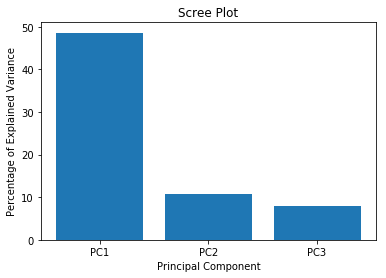

In [17]:
import numpy as np
# Draw a scree plot and a PCA plot

#The following code constructs the Scree plot
per_var = np.round(pca.explained_variance_ratio_* 100, decimals=1)
labels = ['PC' + str(x) for x in range(1, len(per_var)+1)]
 
plt.bar(x=range(1,len(per_var)+1), height=per_var, tick_label=labels)
plt.ylabel('Percentage of Explained Variance')
plt.xlabel('Principal Component')
plt.title('Scree Plot')
plt.show()

## Top 3 components contribute to ~70% of population variance

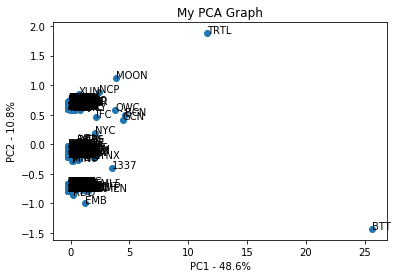

In [18]:
#the following code makes a fancy looking plot using PC1 and PC2

plt.scatter(crypto_pca_df.PC1, crypto_pca_df.PC2)
plt.title('My PCA Graph')
plt.xlabel('PC1 - {0}%'.format(per_var[0]))
plt.ylabel('PC2 - {0}%'.format(per_var[1]))
for sample in crypto_pca_df.index:
    plt.annotate(sample, (crypto_pca_df.PC1.loc[sample], crypto_pca_df.PC2.loc[sample]))
plt.show()
 

In [19]:
# Test x and y labels for PyViz

s3 = "{} - {:.2%}".format("PC1", round(per_var[0]/100,2))
s4 = "{} - {:.2%}".format("PC2", round(per_var[1]/100,2))
print(s3)
print(s4)

PC1 - 49.00%
PC2 - 11.00%


In [20]:
#Pyviz scatter plot with coin name on mouse-hover
#Visually, certain clusters are evident
crypto_pca_df.hvplot(kind="scatter",x='PC1',y='PC2',xlabel=s3,ylabel=s4,hover_cols=['CoinTicker'])

:Scatter   [PC1]   (PC2,CoinTicker)

In [21]:
# Determine which features had the biggest influence on PC1 (Top 10 features)

## loading scores
loading_scores = pd.Series(pca.components_[0], index=crypto_final.columns)
## now sort the loading scores based on their magnitude
sorted_loading_scores = loading_scores.abs().sort_values(ascending=False)
 
# get the names of the top 10 genes
top_10_features = sorted_loading_scores[0:10].index.values
 
## print the gene names and their scores (and +/- sign)
print(loading_scores[top_10_features])

TotalCoinSupply          0.706173
TotalCoinsMined          0.706020
Algorithm_TRC10          0.027510
ProofType_DPoS           0.025934
ProofType_PoW/PoS       -0.022979
Algorithm_CryptoNight    0.018865
Algorithm_X11           -0.013052
ProofType_PoS           -0.011859
Algorithm_SHA-256       -0.007387
ProofType_PoW            0.007358
dtype: float64


## TotalCoinSupply and TotalCoinsMined are key contributors to the PC1 (first component)

In [22]:
# Convert to Dataframe to plot Top 10 features as a Pyviz bar chart

sorted_df=sorted_loading_scores.to_frame()
sorted_df.index.name="Features"
sorted_df.columns=['Values']

sorted_df.head(10).hvplot.bar(x='Features', y='Values', rot=90)

:Bars   [Features]   (Values)

### Clustering Crytocurrencies Using K-Means

#### Finding the Best Value for `k` Using the Elbow Curve

In [23]:
inertia = []
k = list(range(1, 11))

# Calculate the inertia for the range of k values
for i in k:
    km = KMeans(n_clusters=i, random_state=0)
    km.fit(crypto_pca_df)
    inertia.append(km.inertia_)

# Create the Elbow Curve using hvPlot
elbow_data = {"k": k, "inertia": inertia}
df_elbow = pd.DataFrame(elbow_data)
#df_elbow["inertia"].plot()
df_elbow.hvplot.line(x="k", y="inertia", xticks=k, title="Elbow Curve")




:Curve   [k]   (inertia)

In [24]:
#Create function to optimize k-means by generating Elbow Curves
def kmeanoptimizer(input_df,input_k):
    inertia = []
    k = list(range(1, input_k))
    for i in k:
        km = KMeans(n_clusters=i, random_state=0)
        km.fit(input_df)
        inertia.append(km.inertia_)
    elbow_data = {"k": k, "inertia": inertia}
    df_elbow = pd.DataFrame(elbow_data)
    return (df_elbow)

In [25]:
# Create the Elbow Curve using hvPlot. Applied on dimensionality reduced dataset
pca_plot=kmeanoptimizer(crypto_pca_df,11)
pca_plot.hvplot.line(x="k", y="inertia", xticks=11, title="Elbow Curve-Applied on PCA")


:Curve   [k]   (inertia)

In [26]:
# Create the Elbow Curve using hvPlot. Applied on 'raw' dataset i.e. prior to PCA
# Consistent patterns in Intertia; though the significant reduction acheived by  PCA techniques is evident
kmeanoptimizer(crypto_final,11).hvplot.line(x="k", y="inertia", xticks=11, title="Elbow Curve on Raw Dataset")

:Curve   [k]   (inertia)

Running K-Means with `k=<your best value for k here>`

In [27]:
# Initialize the K-Means model

# Fit the model

# Predict clusters

# Create a new DataFrame including predicted clusters and cryptocurrencies features
def get_clusters(k, data):
    # Initialize the K-Means model
    model = KMeans(n_clusters=k, random_state=0)

    # Fit the model
    model.fit(data)

    # Predict clusters
    predictions = model.predict(data)
    
    # Create return DataFrame with predicted clusters
    data["class"] = model.labels_

    return data

In [28]:
# Run function call to label classes
crypto_labeled_df=get_clusters(10,crypto_pca_df)
crypto_labeled_df.head()

# Reinitialize dataframe (create Master) from json dict to capture raw data.
master_df=pd.DataFrame(json_dict['Data'])
master_df=master_df.T
cols = [col for col in master_df.columns if col in ['CoinName', 'Algorithm','IsTrading','ProofType','TotalCoinsMined','TotalCoinSupply']]
master_df = master_df[cols]

# Merge with master
#crypto_feature_pca=pd.concat([master_df, crypto_labeled_df], axis=1)
clustered_df=pd.merge(master_df, crypto_labeled_df, left_index=True, right_index=True)

print(master_df.shape, crypto_labeled_df.shape,clustered_df.shape)
clustered_df.tail()

(5284, 6) (541, 4) (541, 10)


,Algorithm,CoinName,IsTrading,ProofType,TotalCoinSupply,TotalCoinsMined,PC1,PC2,PC3,class
CLOAK,X13,CloakCoin,True,PoW/PoS,0,5.49597e+06,-0.205341,-0.744682,0.107153,2
BCN,CryptoNight,ByteCoin,True,PoW,184467440735,184066828814,4.636381,0.487567,-0.956568,4
BURST,Shabal256,BurstCoin,True,PoC,2158812800,1813033920,-0.133794,-0.065208,-0.063489,5
SC,Blake2b,Siacoin,True,PoW,0,33098296530,0.337526,0.588046,-0.636955,0
POA,Proof-of-Authority,Poa Network,True,PoA,252460800,204479039,-0.178924,-0.062950,-0.059153,5


### Visualizing Results

#### 3D-Scatter with Clusters

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Scatter3D   [x,y,z]
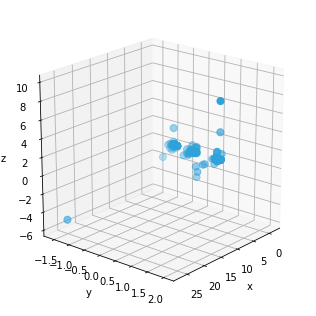

In [29]:
# Create a 3D-Scatter with the PCA data and the clusters
# 3D scatter highlights atleast 5 clusters clearly
import numpy as np
import holoviews as hv
from holoviews import dim, opts

hv.extension('matplotlib')
hv.Scatter3D((crypto_labeled_df.PC1, crypto_labeled_df.PC2, crypto_labeled_df.PC3)).opts(
    opts.Scatter3D(azimuth=40,elevation=20, color='class', s=50, cmap='brg'))


In [30]:
# Create a 3D-Scatter with the PCA data and the clusters
# 3D scatter highlights atleast 5 clusters clearly
import plotly.express as px
fig = px.scatter_3d(clustered_df, x='PC1', y='PC2', z='PC3',
              color='class', size_max=18,
              symbol='class', opacity=0.7, hover_name='CoinName',hover_data=["Algorithm"])

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
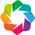

:Table   [CoinName,Algorithm,ProofType,TotalCoinSupply,TotalCoinsMined,class]

In [31]:
import holoviews as hv
from holoviews import opts
hv.extension('bokeh')
clustered_df.hvplot.table(columns=['CoinName', 'Algorithm', "ProofType", "TotalCoinSupply", "TotalCoinsMined", "class"], sortable=True, selectable=True).opts(height=500)

#### Table of Tradable Cryptocurrencies

In [32]:

# Print Initial Shape
initial=master_df.shape[0]

# Slide dataframe
tradable_df=master_df[master_df.IsTrading==True]
tradable_df.head()

,Algorithm,CoinName,IsTrading,ProofType,TotalCoinSupply,TotalCoinsMined
42,Scrypt,42 Coin,True,PoW/PoS,42,42
300,N/A,300 token,True,N/A,300,300
365,X11,365Coin,True,PoW/PoS,2300000000,NaN
404,Scrypt,404Coin,True,PoW/PoS,532000000,1.25571e+06
611,SHA-256,SixEleven,True,PoW,611000,NaN


In [33]:
final=tradable_df.shape[0]
print("Number of coins dropped: {:d}".format(initial-final))

Number of coins dropped: 1087


#### Scatter Plot with Tradable Cryptocurrencies

In [34]:
# Scale data to create the scatter plot
tradable_df=tradable_df.dropna()
scaler=StandardScaler()
graph_df = tradable_df[['CoinName','TotalCoinsMined','TotalCoinSupply']]
graph_df=graph_df.set_index('CoinName')


# Remove all text values
graph_df=graph_df.apply(pd.to_numeric, errors='coerce')
graph_df=graph_df.dropna()
initial_index=graph_df.index
graph_df.head()

#Apply Standard Scaler
#Convert back to Pandas DF
# Plot the scatter with x="TotalCoinsMined" and y="TotalCoinSupply"
graph_df=pd.DataFrame(data=scaler.fit_transform(graph_df),columns=['TotalCoinSupply','TotalCoinsMined'],index=initial_index)
graph_df.hvplot(kind="scatter",x='TotalCoinSupply',y='TotalCoinsMined',hover_cols=['CoinName'])


:Scatter   [TotalCoinSupply]   (TotalCoinsMined,CoinName)